<a href="https://colab.research.google.com/github/sandesh-kun/Vton/blob/main/Saandesh.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install opencv-python


In [2]:
!pip install numpy
!pip install open3d
!pip install matplotlib

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 420.5/420.5 MB 3.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.4/10.4 MB 87.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.1/77.1 kB 8.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.3/139.3 kB 14.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 233.6/233.6 kB 22.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 79.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 56.9 MB/s eta 0:00:00
  Attempting uninstall: widgetsnbextension
    Found existing installation: widgetsnbextension 3.6.5
    Uninstalling widgetsnbextension-3.6.5:
      Successfully uninstalled widgetsnbextension-3.6.5
  Attempting uninstall: werkzeug
    Found existing installation: Werkzeug 2.3.6
    Uninstalling Werkzeug-2.3.6:
      Successfully uninstalled Werkzeug-2.3.6
  Attempting uninstall: ipywidgets
    Found existing installation: ipywidgets

## **Display**

In [17]:
import cv2
import numpy as np
import open3d as o3d
import matplotlib.pyplot as plt
from matplotlib.pylab import *
from mpl_toolkits.mplot3d import Axes3D
import time

class Display:
    def __init__(self):
        self.W = 960
        self.H = 540

    def display_points2d(self, img, kpts, matches):
        if kpts != 0:
            for kpt in kpts:
                cv2.circle(img, (int(kpt.pt[0]), int(kpt.pt[1])), radius=2, color=(0,255,0), thickness=-1)

        if matches != 0:
            for match in matches:
                (u1, v1) = np.int32(match[0].pt)
                (u2, v2) = np.int32(match[1].pt)
                cv2.line(img, (u1, v1), (u2, v2), color=(0,0,255), thickness=1)
        return img

    def display_points3d(self, tripoints3d, pcd, visualizer):
        # open3d
        if tripoints3d is not None:
            pcd.clear()
            pcd.points = o3d.utility.Vector3dVector(tripoints3d)
            visualizer.remove_geometry(pcd)
            visualizer.add_geometry(pcd)
            visualizer.poll_events()
            visualizer.update_renderer()
            time.sleep(.2)

    def display_vid(self, img):
        # Convert image from BGR to RGB
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        plt.figure(figsize=(10,6)) # Optional, adjust the display size
        plt.imshow(img_rgb)
        plt.axis('off')
        plt.show()


# **Extract**

In [18]:
import cv2
import numpy as np

class Extractor(object):
    def __init__(self):
        self.orb = cv2.ORB_create(nfeatures=1000, scoreType=cv2.ORB_FAST_SCORE)
        self.bf = cv2.BFMatcher(cv2.NORM_HAMMING)
        self.last = None

    def extract_keypoints(self, img):
        # Detection
        if len(img.shape) > 2:
            pts = cv2.goodFeaturesToTrack(image=np.mean(img, axis=2).astype(np.uint8),
                                          maxCorners=4500, qualityLevel=0.02, minDistance=3)
        else:
            pts = cv2.goodFeaturesToTrack(image=img.astype(np.uint8),
                                          maxCorners=4500, qualityLevel=0.02, minDistance=3)

        # Extraction
        kpts = [cv2.KeyPoint(p[0][0], p[0][1], size=30) for p in pts]
        kpts, des = self.orb.compute(img, kpts)

        # Matching
        ret = []
        if self.last is not None:
            matches = self.bf.knnMatch(des, self.last["des"], k=2)
            for m, n in matches:
                if m.distance < 0.55 * n.distance and m.distance < 64:
                    kpt1_match = kpts[m.queryIdx]
                    kpt2_match = self.last["kpts"][m.trainIdx]
                    ret.append((kpt1_match, kpt2_match))

            coords1_match_pts = np.asarray([kpts[m.queryIdx].pt for m, n in matches])
            coords2_match_pts = np.asarray([self.last["kpts"][m.trainIdx].pt for m, n in matches])

            # Find transformation between two matched points
            retval, mask = cv2.findHomography(coords1_match_pts, coords2_match_pts, cv2.RANSAC, 100.0)
            mask = mask.ravel()

            pts1 = coords1_match_pts[mask == 1]
            pts2 = coords2_match_pts[mask == 1]

            self.last = {"kpts": kpts, "des": des}
            return pts1.T, pts2.T, kpts, ret

        else:
            self.last = {"kpts": kpts, "des": des}
            return np.array([0]), np.array([0]), [], []


# **Normalize**

In [19]:
import numpy as np


def scale_and_transform_points(points):
	x = points[0]
	y = points[1]

	center = points.mean(axis=1)

	cx = x - center[0]
	cy = y - center[1]

	distance = np.sqrt(np.power(cx, 2) + np.power(cy, 2))
	scale = np.sqrt(2) / distance.mean()

	norm3d = np.array([
		[scale, 0, -scale*center[0]],	#x
		[0, scale, -scale*center[1]],	#y
		[0, 0, 1]])			#z

	return np.dot(norm3d, points), norm3d


def correspondence_matrix(p1, p2):
	p1x, p1y = p1[:2]
	p2x, p2y = p2[:2]

	return np.array([
		p1x * p2x, p1x * p2y, p1x,
		p1y * p2x, p1y * p2y, p1y,
		p2x, p2y, np.ones(len(p1x))
		]).T

	return np.array([
		p2x * p1x, p2x * p1y, p2x,
        p2y * p1x, p2y * p1y, p2y,
        p1x, p1y, np.ones(len(p1x))
        ]).T


def compute_img_to_img_matrix(x1, x2, compute_essential=False):
	A = correspondence_matrix(x1, x2)
	U, S, V = np.linalg.svd(A)
	F = V[-1].reshape(3, 3)

	U, S, V = np.linalg.svd(F)
	S[-1] = 0
	if compute_essential:
		S = [1, 1, 0] # Force rank 2 and equal eigenvalues
	F = np.dot(U, np.dot(np.diag(S), V))

	return F


def compute_essential_normalized_matrix(p1, p2, compute_essential=False):
	if p1.shape != p2.shape:
		raise ValueError("Numbers of p1 and p2 don´t match !")

	# preprocess img coords
	p1n, T1 = scale_and_transform_points(p1)
	p2n, T2 = scale_and_transform_points(p2)

	# compute F
	F = compute_img_to_img_matrix(p1n, p2n, compute_essential)

	F = np.dot(T1.T, np.dot(F, T2))

	F = F / F[2, 2]

	return F


def compute_essential_normalized(p1, p2):
	return compute_essential_normalized_matrix(p1, p2, compute_essential=True)


def compute_P_from_essential(E):
	U, S, V = np.linalg.svd(E)

	if np.linalg.det(np.dot(U, V)) < 0:
		V = -V

	W = np.array([[0, -1, 0], [1, 0, 0], [0, 0, 1]])
	P2s = [
		np.vstack((np.dot(U, np.dot(W, V)).T, U[:, 2])).T,
		np.vstack((np.dot(U, np.dot(W, V)).T, -U[:, 2])).T,
		np.vstack((np.dot(U, np.dot(W.T, V)).T, U[:, 2])).T,
		np.vstack((np.dot(U, np.dot(W.T, V)).T, -U[:, 2])).T]

	return P2s


def skew(x):
	return np.array([
		[0, -x[2], x[1]],
		[x[2], 0, -x[0]],
		[-x[1], x[0], 0]])


def reconstruct_one_point(pt1, pt2, m1, m2):
	A = np.vstack([
		np.dot(skew(pt1), m1),
		np.dot(skew(pt2), m2)])

	U, S, V = np.linalg.svd(A)
	P = np.ravel(V[-1, :4])

	return P / P[3]


def triangulation(p1, p2, m1, m2):
	num_points = p1.shape[1]
	res = np.ones((4, num_points))

	for i in range(num_points):
		A = np.asarray([
			(p1[0, i] * m1[2, :] - m1[0, :]),
			(p1[1, i] * m1[2, :] - m1[1, :]),
			(p2[0, i] * m2[2, :] - m2[0, :]),
			(p2[1, i] * m2[2, :] - m2[1, :])])

		_, _, V = np.linalg.svd(A)
		X = V[-1, :4]
		res[:, i] = X / X[3]

	return res

# **Slam**

In [20]:
import cv2
import numpy as np
import open3d as o3d


display = Display()
extractor = Extractor()


def process(img):
	pts1, pts2, kpts, matches = extractor.extract_keypoints(img=img)

	# converto to 3 dimensional
	points1 = cart2hom(pts1)
	points2 = cart2hom(pts2)

	img_h, img_w, img_ch = img.shape

	intrinsic = np.array([[3000,0,img_w/2],
				[0,3000,img_h/2],
				[0,0,1]])
	tripoints3d = []
	if points1.ndim != 1 or points2.ndim != 1:
		points1_norm = np.dot(np.linalg.inv(intrinsic), points1)
		points2_norm = np.dot(np.linalg.inv(intrinsic), points2)

		E = compute_essential_normalized(points1_norm, points2_norm)

		P1 = np.array([[1,0,0,0], [0,1,0,0], [0,0,1,0]])
		P2s = compute_P_from_essential(E)

		ind = -1
		for i, P2 in enumerate(P2s):
			d1 = reconstruct_one_point(points1_norm[:, 0], points2_norm[:, 0], P1, P2)

			P2_homogenous = np.linalg.inv(np.vstack([P2, [0,0,0,1]]))

			d2 = np.dot(P2_homogenous[:3, :4], d1)

			if d1[2] > 0 and d2[2] > 0:
				ind = i

		P2 = np.linalg.inv(np.vstack([P2s[ind], [0, 0, 0, 1]]))[:3, :4]
		tripoints3d = triangulation(points1_norm, points2_norm, P1, P2)

	else:
		print("Wrong dimension of array")
		pass

	return img, tripoints3d, kpts, matches

# **Pointmap**

In [21]:
import numpy as np
import open3d as o3d
import cv2


class PointMap(object):
	def __init__(self):
		self.array = [0,0,0]

	def collect_points(self, tripoints):
		if len(tripoints) > 0:
			array_to_project = np.array([0,0,0])

			x_points = [pt for pt in tripoints[0]]
			y_points = [-pt for pt in tripoints[1]]
			z_points = [-pt for pt in tripoints[2]]

			for i in range(tripoints.shape[1]):
				curr_array = np.array([x_points[i], y_points[i], z_points[i]])
				array_to_project = np.vstack((array_to_project, curr_array))

			array_to_project = array_to_project[1:, :]

			return array_to_project

Converter

In [22]:
import numpy as np
import open3d as o3d
import cv2


class PointMap(object):
	def __init__(self):
		self.array = [0,0,0]

	def collect_points(self, tripoints):
		if len(tripoints) > 0:
			array_to_project = np.array([0,0,0])

			x_points = [pt for pt in tripoints[0]]
			y_points = [-pt for pt in tripoints[1]]
			z_points = [-pt for pt in tripoints[2]]

			for i in range(tripoints.shape[1]):
				curr_array = np.array([x_points[i], y_points[i], z_points[i]])
				array_to_project = np.vstack((array_to_project, curr_array))

			array_to_project = array_to_project[1:, :]

			return array_to_project

# ***Convertor***

## **Main**

In [23]:
import cv2
import numpy as np


def cart2hom(array):
	"""Convert array from Cartesian -> Homogenous (2 dimensions -> 3 dimensions)"""
	if array.ndim == 1:
		return np.array([0])

	else:
		array_3dim = np.asarray(np.vstack([array, np.ones(array.shape[1])]))
		return array_3dim


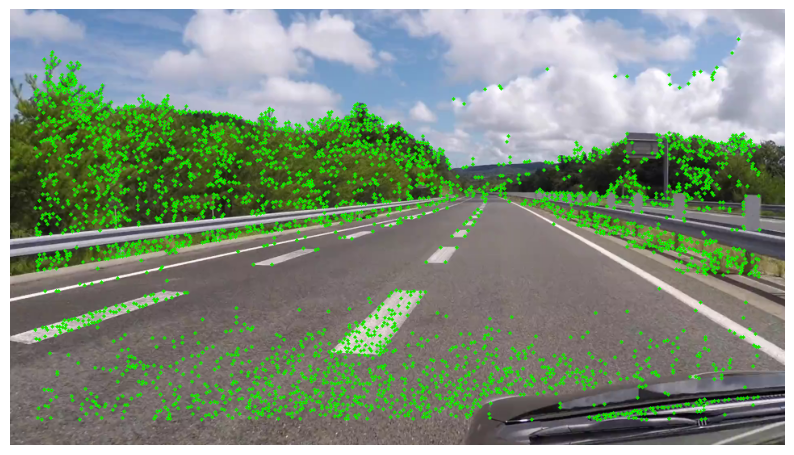

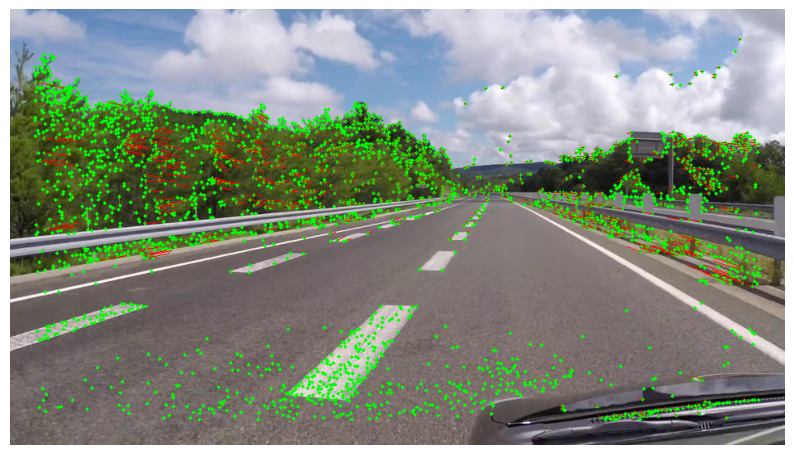

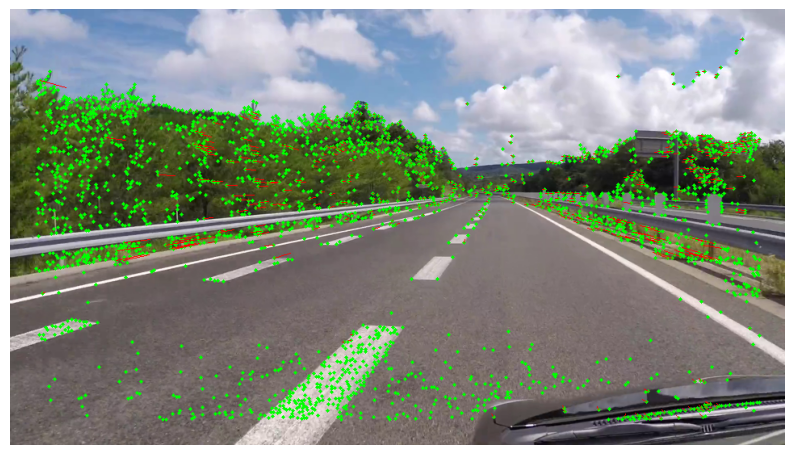

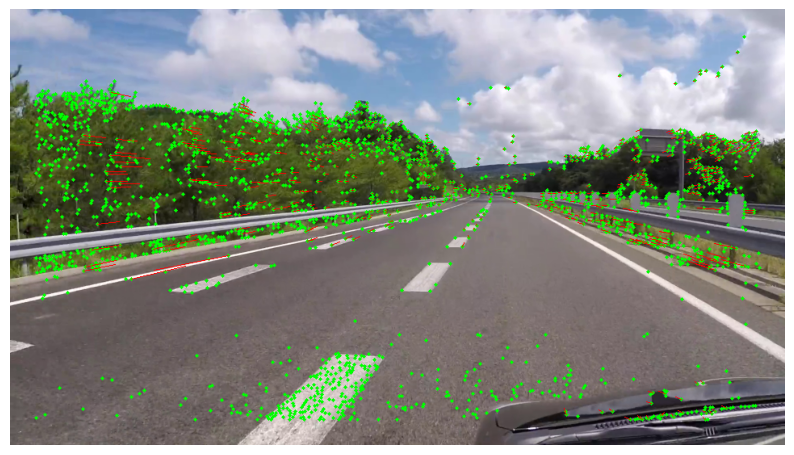

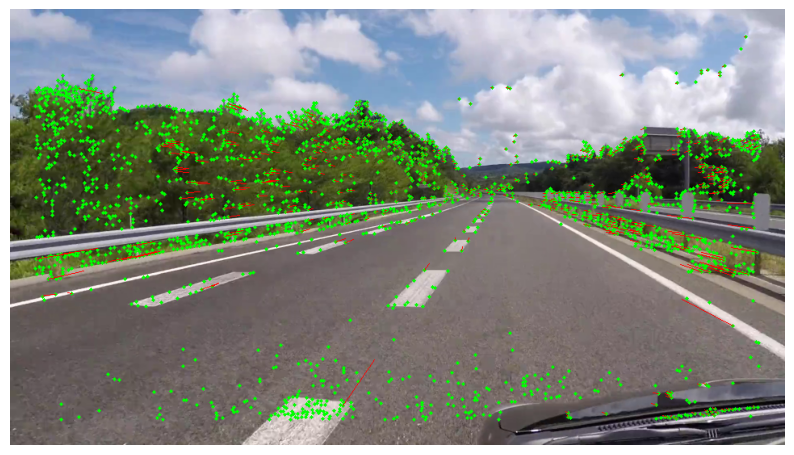

...

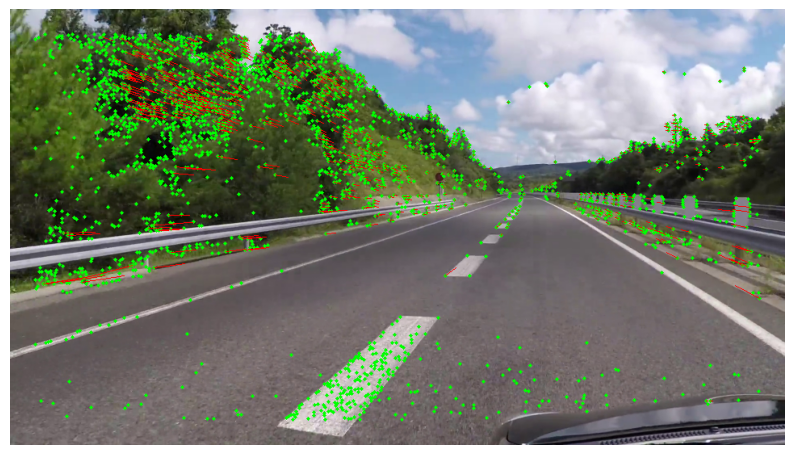

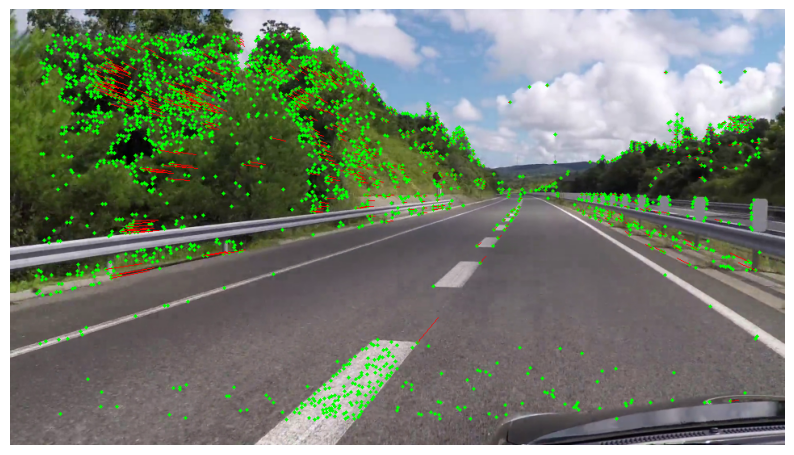

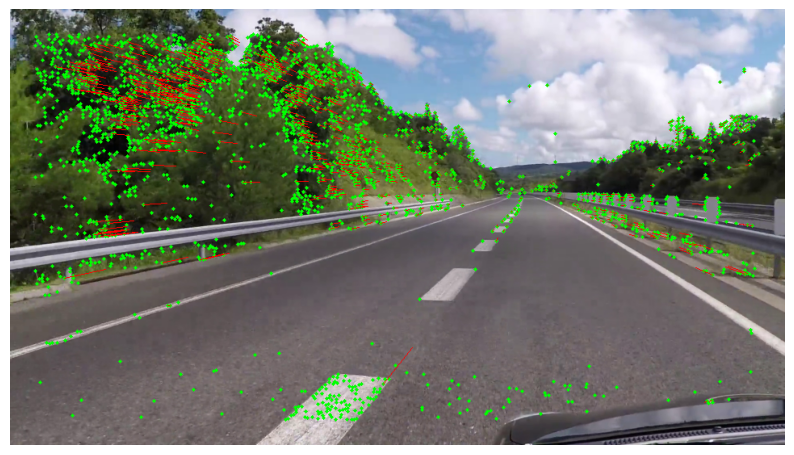

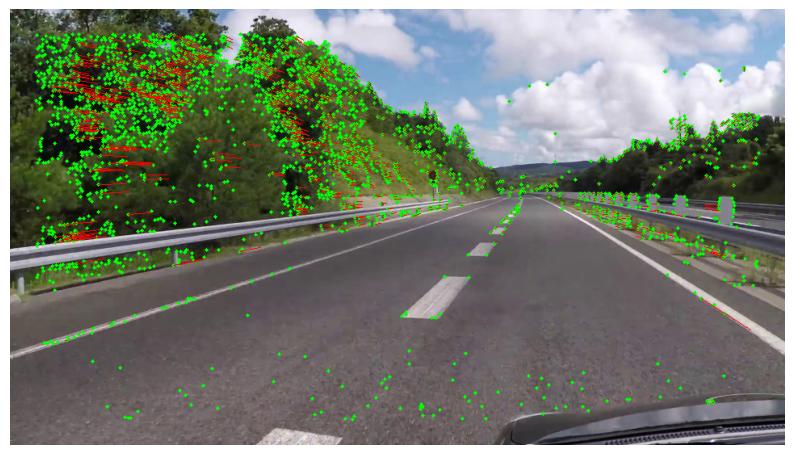

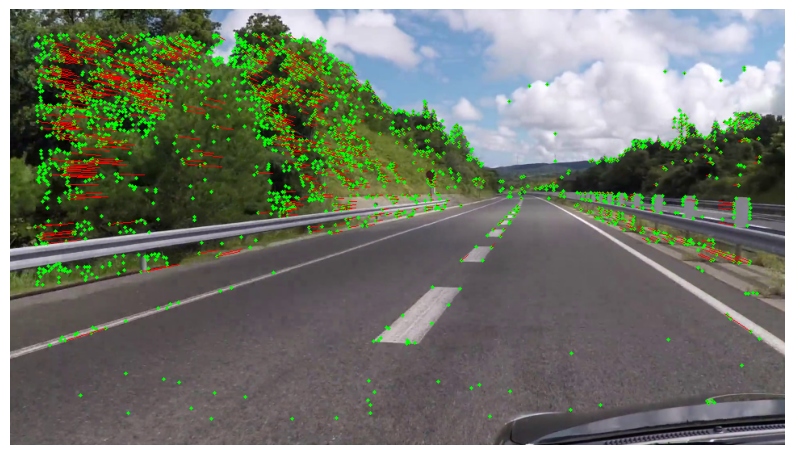

Buffered data was truncated after reaching the output size limit.

In [ ]:
import cv2
import open3d as o3d
import os
import numpy as np
import matplotlib.pyplot as plt

# Your PointMap and Display classes definitions can remain unchanged.

pmap = PointMap()
display = Display()

def main():
    cap = cv2.VideoCapture("/content/test_video4.mp4")

    # Check if a GUI is available.
    has_gui = "DISPLAY" in os.environ

    if has_gui:
        pcd = o3d.geometry.PointCloud()
        visualizer = o3d.visualization.Visualizer()
        visualizer.create_window(window_name="3D plot", width=960, height=540)

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        frame = cv2.resize(frame, (960, 540))
        img, tripoints, kpts, matches = process(frame) # Ensure the process function is defined and included
        xyz = pmap.collect_points(tripoints)

        if kpts is not None or matches is not None:
            display.display_points2d(frame, kpts, matches)
        display.display_vid(frame)

        if has_gui and xyz is not None:
            display.display_points3d(xyz, pcd, visualizer)

    #     if cv2.waitKey(1) == 27: # Escape key
    #         break

    # cv2.destroyAllWindows()
    # cap.release()

if __name__ == '__main__':
    main()
